# Notebook to perform QC - Version2 

**Developed by** : Srivalli Kolla

**Würzburg Institute for Systems Immunology - JMU-Würzburg**

**Created on** : April 10, 2024

**Modified on** : April 12,2024

# Importing packages

In [1]:
import anndata
import logging
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sb
import scrublet as scr
import matplotlib.pyplot as plt

# Environment setup

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 250, color_map = 'RdPu', dpi_save = 180, vector_friendly = True, format = 'svg')

-----
anndata     0.10.5.post1
scanpy      1.9.8
-----
PIL                 10.2.0
appnope             0.1.4
asttokens           NA
cffi                1.16.0
comm                0.2.1
cycler              0.12.1
cython_runtime      NA
dateutil            2.8.2
debugpy             1.8.1
decorator           5.1.1
executing           2.0.1
h5py                3.10.0
igraph              0.10.8
ipykernel           6.29.3
jedi                0.19.1
joblib              1.3.2
kiwisolver          1.4.5
leidenalg           0.10.2
llvmlite            0.42.0
louvain             0.8.1
matplotlib          3.8.3
mpl_toolkits        NA
natsort             8.4.0
numba               0.59.0
numpy               1.26.4
packaging           23.2
pandas              2.2.1
parso               0.8.3
patsy               0.5.6
pickleshare         0.7.5
pkg_resources       NA
platformdirs        4.2.0
prompt_toolkit      3.0.42
psutil              5.9.8
pure_eval           0.2.2
pydev_ipython       NA
pydevconsole 

## Reading individual anndata objects and predicting doublets per sample

In [3]:
vascular = sc.read_h5ad("../Data/hca_heart_vascular_raw.h5ad")
vascular

AnnData object with n_obs × n_vars = 195395 × 33538
    obs: 'NRP', 'age_group', 'cell_source', 'cell_type', 'donor', 'gender', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states', 'Used'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45'
    uns: 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'

## Filtration

In [4]:
sc.pp.filter_cells(vascular, min_genes= 200)
vascular

AnnData object with n_obs × n_vars = 195395 × 33538
    obs: 'NRP', 'age_group', 'cell_source', 'cell_type', 'donor', 'gender', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states', 'Used'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45'
    uns: 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'

In [5]:
vascular.obs

,NRP,age_group,cell_source,cell_type,donor,gender,n_counts,n_genes,percent_mito,percent_ribo,region,sample,scrublet_score,source,type,version,cell_states,Used
AAGACCTGTACTTGAC-1-HCAHeart7606896,No,50-55,Sanger-Cells,Smooth_muscle_cells,D1,Female,5236.0,1714,0.055959,0.050420,AX,HCAHeart7606896,0.164733,Cells,DBD,V2,SMC2_art,Yes
ACAGCTACACAAGACG-1-HCAHeart7606896,No,50-55,Sanger-Cells,Pericytes,D1,Female,9139.0,3043,0.049568,0.065215,AX,HCAHeart7606896,0.185751,Cells,DBD,V2,PC3_str,Yes
ACATCAGCATGACATC-1-HCAHeart7606896,No,50-55,Sanger-Cells,Pericytes,D1,Female,901.0,459,0.130966,0.048835,AX,HCAHeart7606896,0.102990,Cells,DBD,V2,PC1_vent,Yes
ACCCACTTCTGTCCGT-1-HCAHeart7606896,No,50-55,Sanger-Cells,Smooth_muscle_cells,D1,Female,3419.0,1220,0.090962,0.041533,AX,HCAHeart7606896,0.164733,Cells,DBD,V2,SMC2_art,Yes
ACCTTTATCAATACCG-1-HCAHeart7606896,No,50-55,Sanger-Cells,Pericytes,D1,Female,5497.0,2177,0.075860,0.047480,AX,HCAHeart7606896,0.155556,Cells,DBD,V2,PC3_str,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGCGTCTCGAAGGAC-1-H0037_septum,No,55-60,Harvard-Nuclei,Endothelial,H4,Male,723.0,567,0.017981,0.000000,SP,H0037_septum,0.226190,Nuclei,DBD,V3,EC2_cap,Yes
TTGCTGCTCTTTGCGC-1-H0037_septum,No,55-60,Harvard-Nuclei,Endothelial,H4,Male,515.0,389,0.015534,0.000000,SP,H0037_septum,0.065657,Nuclei,DBD,V3,EC3_cap,Yes
TTGGTTTTCTTAGCAG-1-H0037_septum,No,55-60,Harvard-Nuclei,Endothelial,H4,Male,820.0,594,0.006098,0.000000,SP,H0037_septum,0.065657,Nuclei,DBD,V3,EC2_cap,Yes
TTTGTTGAGGTAGATT-1-H0037_septum,No,55-60,Harvard-Nuclei,Endothelial,H4,Male,621.0,473,0.003221,0.000000,SP,H0037_septum,0.057715,Nuclei,DBD,V3,EC1_cap,Yes


###### We don't have any cells having less than 200 genes

## Doublet score prediction

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.31
Detected doublet rate = 1.1%
Estimated detectable doublet fraction = 12.4%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 8.5%
Elapsed time: 0.3 seconds
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.43
Detected doublet rate = 0.4%
Estimated detectable doublet fraction = 10.1%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 3.8%
Elapsed time: 0.3 seconds
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.38
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 10.6%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 3.1%
Elapsed time: 0.2 seconds
Preprocessing...
Simulating double

/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scrublet/helper_functions.py:251: RuntimeWarning: invalid value encountered in sqrt
  CV_eff = np.sqrt((1+a)*(1+b) - 1);


Simulating doublets...
Embedding transcriptomes using PCA...
Error occurred for sample HCAHeart7728605: n_components=30 must be between 1 and min(n_samples, n_features)=22 with svd_solver='arpack'
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.42
Detected doublet rate = 1.0%
Estimated detectable doublet fraction = 19.0%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 5.0%
Elapsed time: 0.3 seconds
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.38
Detected doublet rate = 1.0%
Estimated detectable doublet fraction = 13.6%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 7.3%
Elapsed time: 0.1 seconds
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.37

/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scrublet/scrublet.py:485: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1, 2, figsize = fig_size)


Calculating doublet scores...
Automatically set threshold at doublet score = 0.43
Detected doublet rate = 1.4%
Estimated detectable doublet fraction = 6.0%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 23.0%
Elapsed time: 0.3 seconds
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 2.9%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 9.0%
Elapsed time: 1.2 seconds
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.48
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 6.8%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 2.4%
Elapsed time: 0.5 seconds
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automa

/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])


Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.4%
Estimated detectable doublet fraction = 15.9%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 2.5%
Elapsed time: 0.7 seconds
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.55
Detected doublet rate = 0.5%
Estimated detectable doublet fraction = 13.1%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 4.2%
Elapsed time: 0.6 seconds
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.36
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 1.3%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 12.5%
Elapsed time: 0.1 seconds
Preprocessing...
Simulating double

/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


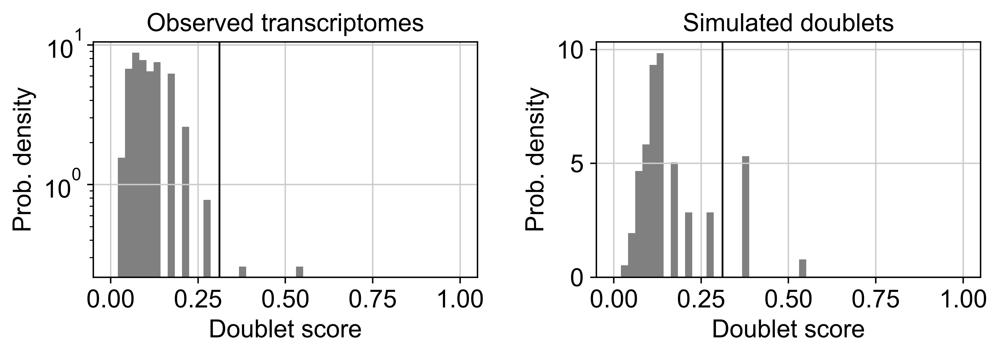

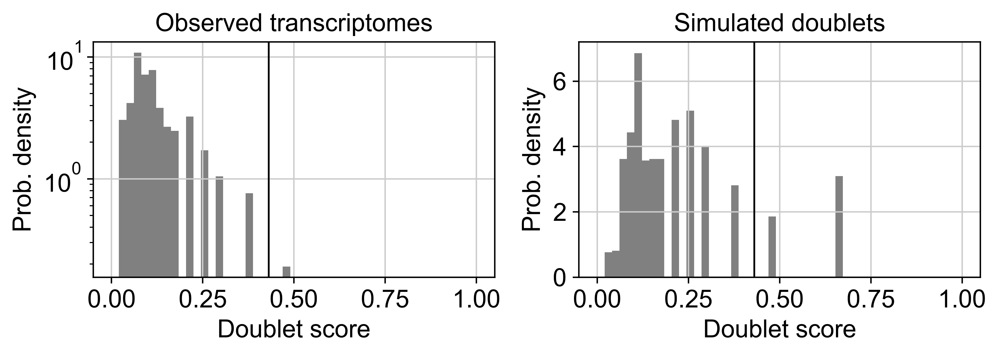

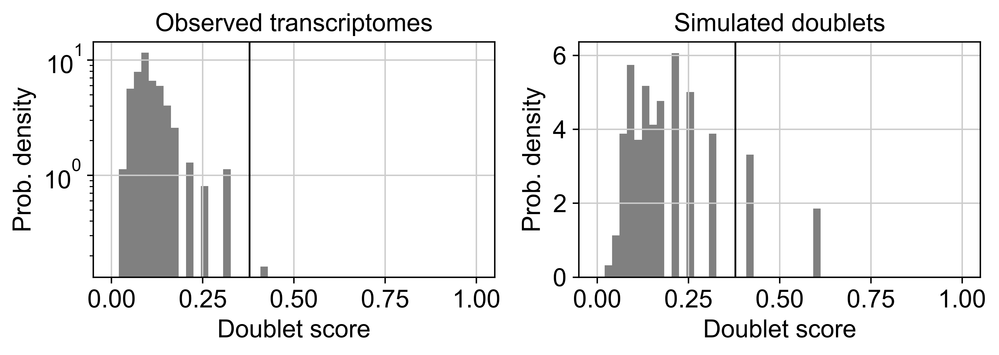

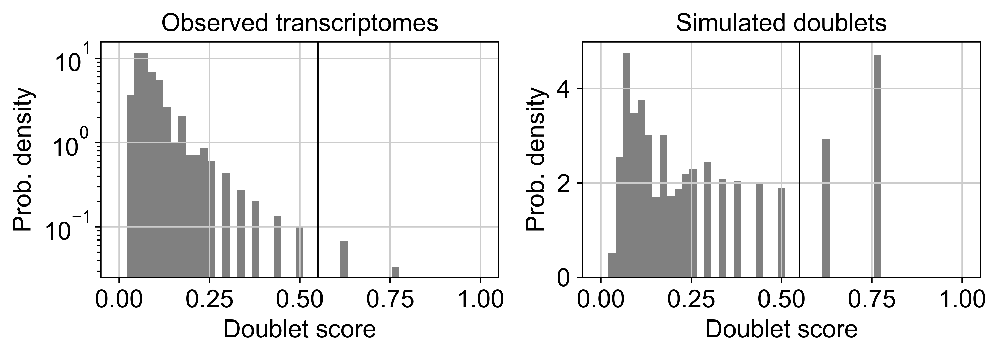

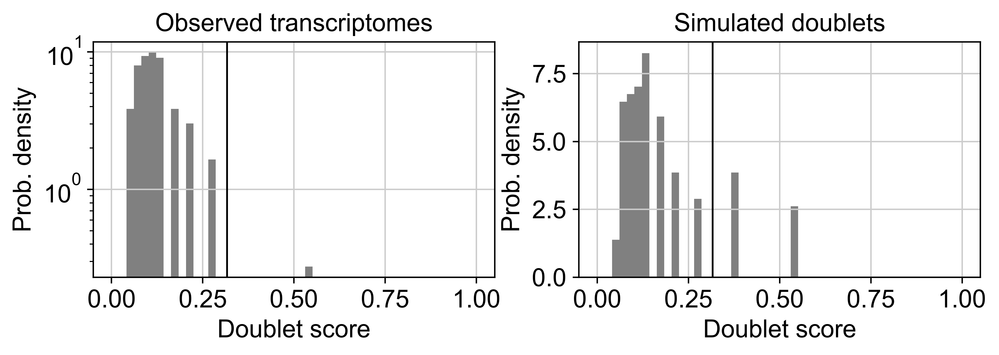

...

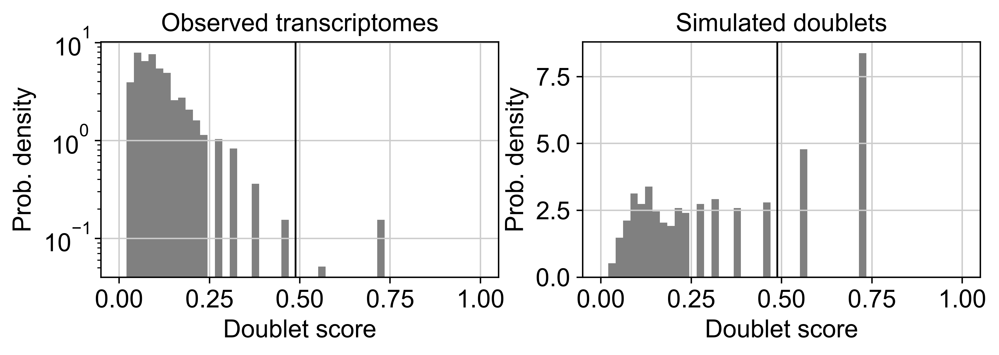

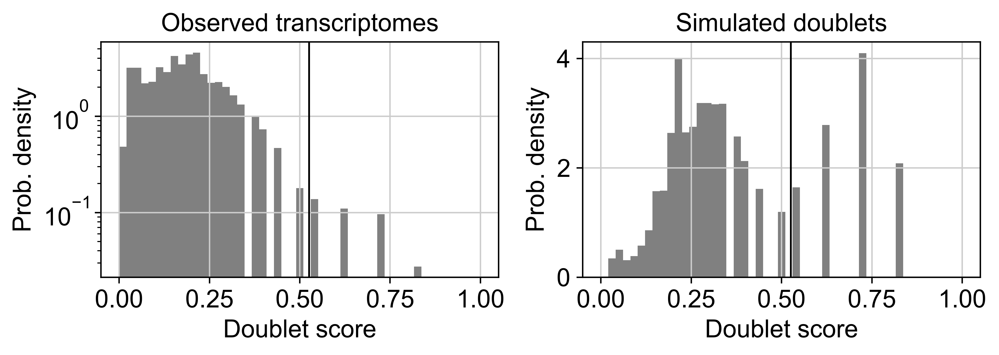

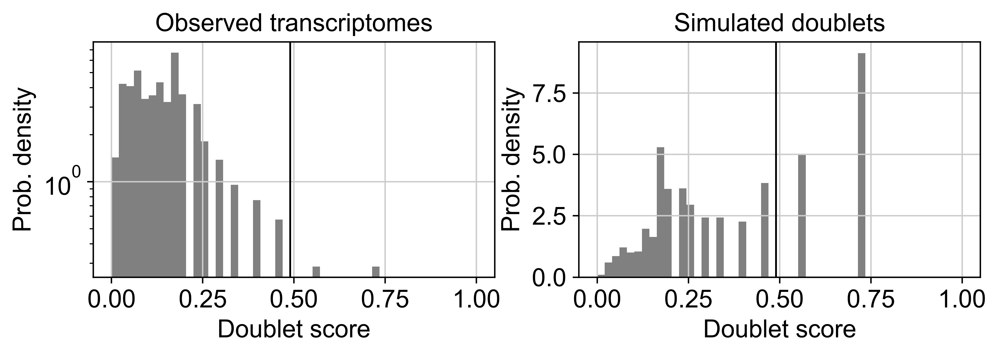

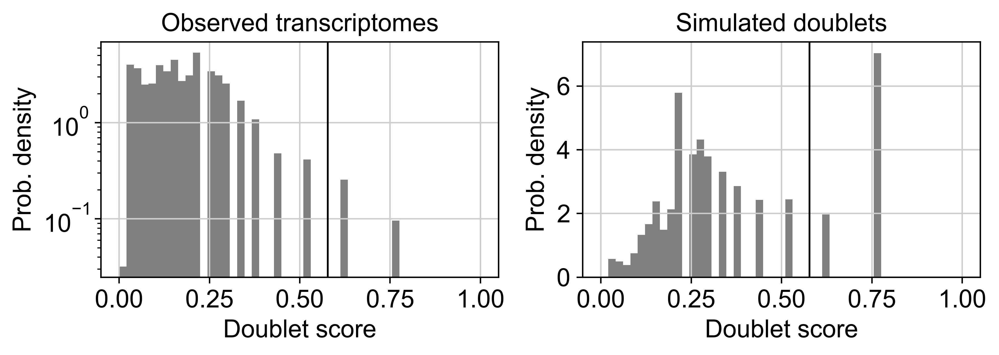

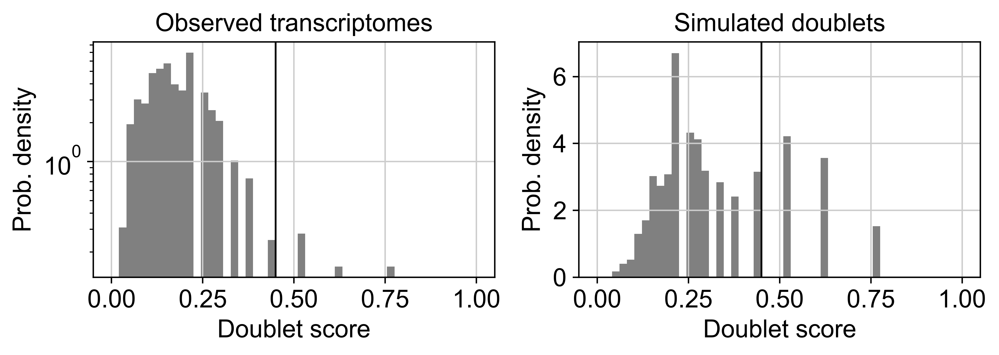

In [6]:
# List of samples
sample_names = vascular.obs['sample'].unique()

# Making anndata object for each sample
for sample_name in sample_names:
    try:
        #SUbsetting samples based on sample_name
        sample_subset = vascular.obs['sample'] == sample_name
        sample_vascular = vascular[sample_subset].copy()

        # Doublet score calculation
        scrub = scr.Scrublet(sample_vascular.X)
        sample_vascular.obs['doublet_scores'], sample_vascular.obs['predicted_doublets'] = scrub.scrub_doublets()

        # Assign doublet scores to the sample
        vascular.obs.loc[sample_subset, 'doublet_scores'] = sample_vascular.obs['doublet_scores']
        vascular.obs.loc[sample_subset, 'predicted_doublets'] = sample_vascular.obs['predicted_doublets']

        #Plotting
        scrub.plot_histogram()
    
    except Exception as e:
        print(f"Error occurred for sample {sample_name}: {str(e)}")

In [7]:
print(list(sample_names)[-5:])

['H0037_LA_corr', 'H0037_RV', 'H0037_septum', 'HCAHeart7728609', 'HCAHeart7757637']


###### As sample_name is categorical. it is converted to list to check the tail to see position of sample 'HCAHeart7757637'. From this, we can understand that as the last sample has no enough dimensions, it has been considered as an exception

In [8]:
vascular

AnnData object with n_obs × n_vars = 195395 × 33538
    obs: 'NRP', 'age_group', 'cell_source', 'cell_type', 'donor', 'gender', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states', 'Used', 'doublet_scores', 'predicted_doublets'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45'
    uns: 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'

#### Checking the count of Doublets

In [9]:
doub_tab = pd.crosstab(vascular.obs['sample'],vascular.obs['predicted_doublets'])

In [10]:
doub_tab.sum()

predicted_doublets
False    194007
True       1333
dtype: int64

In [11]:
mod_vascular = vascular.copy()
mod_vascular

AnnData object with n_obs × n_vars = 195395 × 33538
    obs: 'NRP', 'age_group', 'cell_source', 'cell_type', 'donor', 'gender', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states', 'Used', 'doublet_scores', 'predicted_doublets'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45'
    uns: 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'

## Computing QC

In [12]:
mod_vascular

AnnData object with n_obs × n_vars = 195395 × 33538
    obs: 'NRP', 'age_group', 'cell_source', 'cell_type', 'donor', 'gender', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states', 'Used', 'doublet_scores', 'predicted_doublets'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45'
    uns: 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'

### Labelling Mt and Ribo genes

In [13]:
mod_vascular.var['MT'] = mod_vascular.var_names.str.startswith('MT-') 
mod_vascular.var['RIBO'] = mod_vascular.var_names.str.startswith(("RPS","RPL"))
mod_vascular.var

,gene_ids-Harvard-Nuclei,feature_types-Harvard-Nuclei,gene_ids-Sanger-Nuclei,feature_types-Sanger-Nuclei,gene_ids-Sanger-Cells,feature_types-Sanger-Cells,gene_ids-Sanger-CD45,feature_types-Sanger-CD45,MT,RIBO
MIR1302-2HG,ENSG00000243485,Gene Expression,ENSG00000243485,0,ENSG00000243485,0,ENSG00000243485,0,False,False
FAM138A,ENSG00000237613,Gene Expression,ENSG00000237613,0,ENSG00000237613,0,ENSG00000237613,0,False,False
OR4F5,ENSG00000186092,Gene Expression,ENSG00000186092,0,ENSG00000186092,0,ENSG00000186092,0,False,False
AL627309.1,ENSG00000238009,Gene Expression,ENSG00000238009,0,ENSG00000238009,0,ENSG00000238009,0,False,False
AL627309.3,ENSG00000239945,Gene Expression,ENSG00000239945,0,ENSG00000239945,0,ENSG00000239945,0,False,False
...,...,...,...,...,...,...,...,...,...,...
AC233755.2,ENSG00000277856,Gene Expression,ENSG00000277856,0,ENSG00000277856,0,ENSG00000277856,0,False,False
AC233755.1,ENSG00000275063,Gene Expression,ENSG00000275063,0,ENSG00000275063,0,ENSG00000275063,0,False,False
AC240274.1,ENSG00000271254,Gene Expression,ENSG00000271254,0,ENSG00000271254,0,ENSG00000271254,0,False,False
AC213203.1,ENSG00000277475,Gene Expression,ENSG00000277475,0,ENSG00000277475,0,ENSG00000277475,0,False,False


In [14]:
mt_ribo_tab = pd.crosstab(mod_vascular.var['RIBO'], mod_vascular.var['MT'])
mt_ribo_tab

MT,False,True
RIBO,,
False,33421,13
True,104,0


In [15]:
mod_vascular.var

,gene_ids-Harvard-Nuclei,feature_types-Harvard-Nuclei,gene_ids-Sanger-Nuclei,feature_types-Sanger-Nuclei,gene_ids-Sanger-Cells,feature_types-Sanger-Cells,gene_ids-Sanger-CD45,feature_types-Sanger-CD45,MT,RIBO
MIR1302-2HG,ENSG00000243485,Gene Expression,ENSG00000243485,0,ENSG00000243485,0,ENSG00000243485,0,False,False
FAM138A,ENSG00000237613,Gene Expression,ENSG00000237613,0,ENSG00000237613,0,ENSG00000237613,0,False,False
OR4F5,ENSG00000186092,Gene Expression,ENSG00000186092,0,ENSG00000186092,0,ENSG00000186092,0,False,False
AL627309.1,ENSG00000238009,Gene Expression,ENSG00000238009,0,ENSG00000238009,0,ENSG00000238009,0,False,False
AL627309.3,ENSG00000239945,Gene Expression,ENSG00000239945,0,ENSG00000239945,0,ENSG00000239945,0,False,False
...,...,...,...,...,...,...,...,...,...,...
AC233755.2,ENSG00000277856,Gene Expression,ENSG00000277856,0,ENSG00000277856,0,ENSG00000277856,0,False,False
AC233755.1,ENSG00000275063,Gene Expression,ENSG00000275063,0,ENSG00000275063,0,ENSG00000275063,0,False,False
AC240274.1,ENSG00000271254,Gene Expression,ENSG00000271254,0,ENSG00000271254,0,ENSG00000271254,0,False,False
AC213203.1,ENSG00000277475,Gene Expression,ENSG00000277475,0,ENSG00000277475,0,ENSG00000277475,0,False,False


In [16]:
sc.pp.calculate_qc_metrics(mod_vascular, qc_vars = ['MT','RIBO'], percent_top = None, log1p = False, inplace = True)

In [17]:
#Seperating Mt genes
mito_genes = mod_vascular.var_names.str.startswith('MT-')

#Calculating Mt gene percentage
mod_vascular.obs['percent_mt2'] = np.sum(
    mod_vascular[:, mito_genes].X, axis = 1) / np.sum(mod_vascular.X, axis = 1)

#ReCalculating n_counts
mod_vascular.obs['n_counts2'] = mod_vascular.X.sum(axis = 1)

In [18]:
mod_vascular

AnnData object with n_obs × n_vars = 195395 × 33538
    obs: 'NRP', 'age_group', 'cell_source', 'cell_type', 'donor', 'gender', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states', 'Used', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_MT', 'pct_counts_MT', 'total_counts_RIBO', 'pct_counts_RIBO', 'percent_mt2', 'n_counts2'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45', 'MT', 'RIBO', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'

### Visualise QC covariates

([0, 1, 2, 3],
 [Text(0, 0, 'n_genes'),
  Text(1, 0, 'n_counts'),
  Text(2, 0, 'percent_mito'),
  Text(3, 0, 'percent_ribo')])

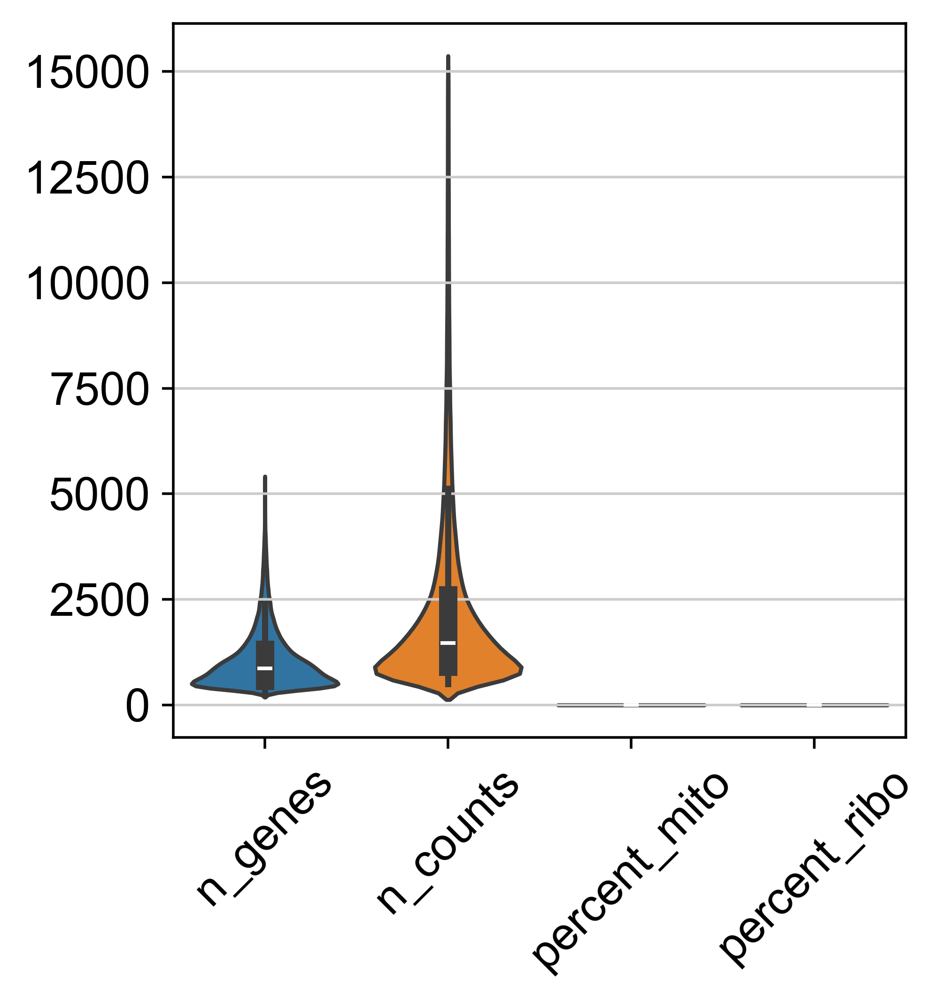

In [19]:
# Define the variables to be plotted
variables = ['n_genes', 'n_counts', 'percent_mito', 'percent_ribo']

# Create the violin plot
sb.violinplot(data=mod_vascular.obs[variables])

# Tilt the x-axis labels
plt.xticks(rotation=45)

##### *Description of violin plots*

**Violin Body**: The central part of the violin plot represents the probability density of the data.

**Box Plot**:
        Median (White line inside the box) Q2 ;
        Quartiles (the edges of the box) Q1,Q3 - Height of box represent Interquartile region (Q1-Q2-Q3) ;
        Outliers (points beyond the whiskers)

**Whiskers**: The whiskers extend from the box to the minimum and maximum values within 1.5 times the IQR from the first and third quartiles

**Outliers**: Individual data points beyond the whiskers

([0, 1], [Text(0, 0, 'percent_mito'), Text(1, 0, 'percent_ribo')])

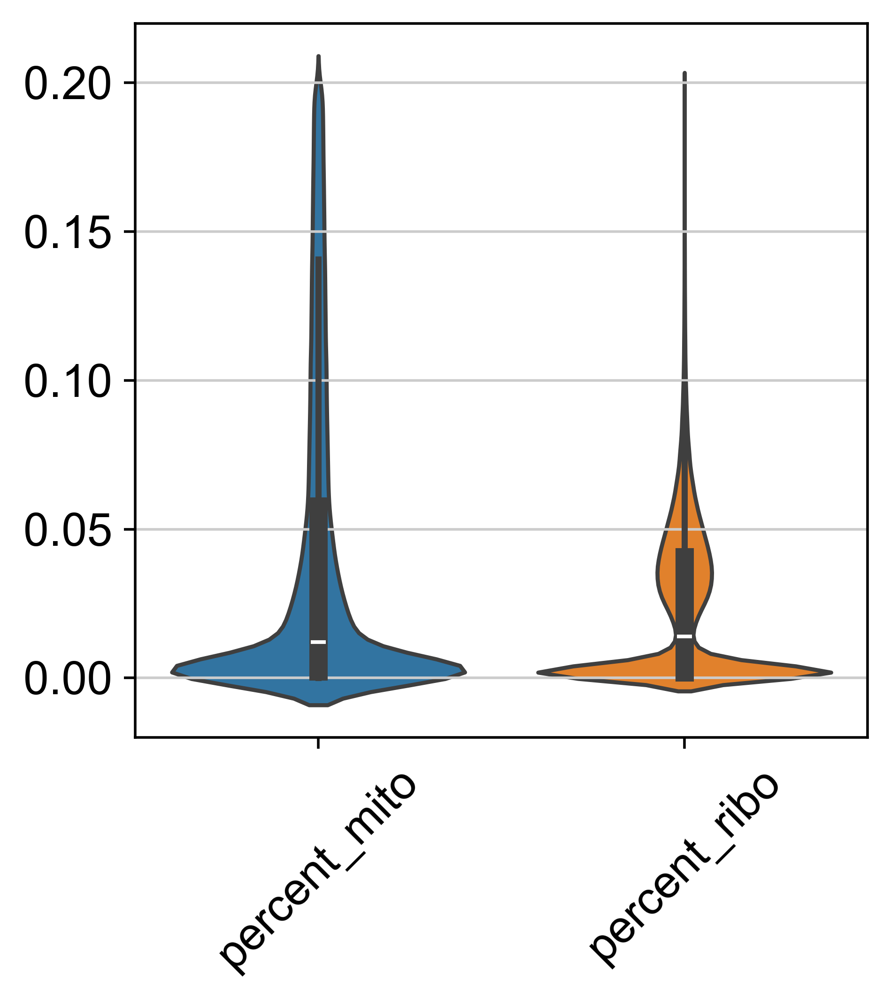

In [20]:
# Define the variables to be plotted
variables = ['percent_mito', 'percent_ribo']

# Create the violin plot
sb.violinplot(data=mod_vascular.obs[variables])

# Tilt the x-axis labels
plt.xticks(rotation=45)

the obs value 'sample' has more than 103 categories. Uniform 'grey' color will be used for all categories.


/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has b

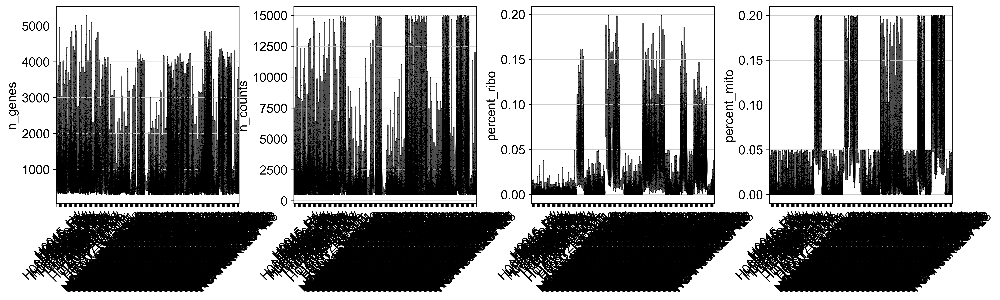

In [21]:
sc.pl.violin(mod_vascular,['n_genes','n_counts','percent_ribo','percent_mito'],jitter = 0.2, groupby = 'sample', rotation = 45)

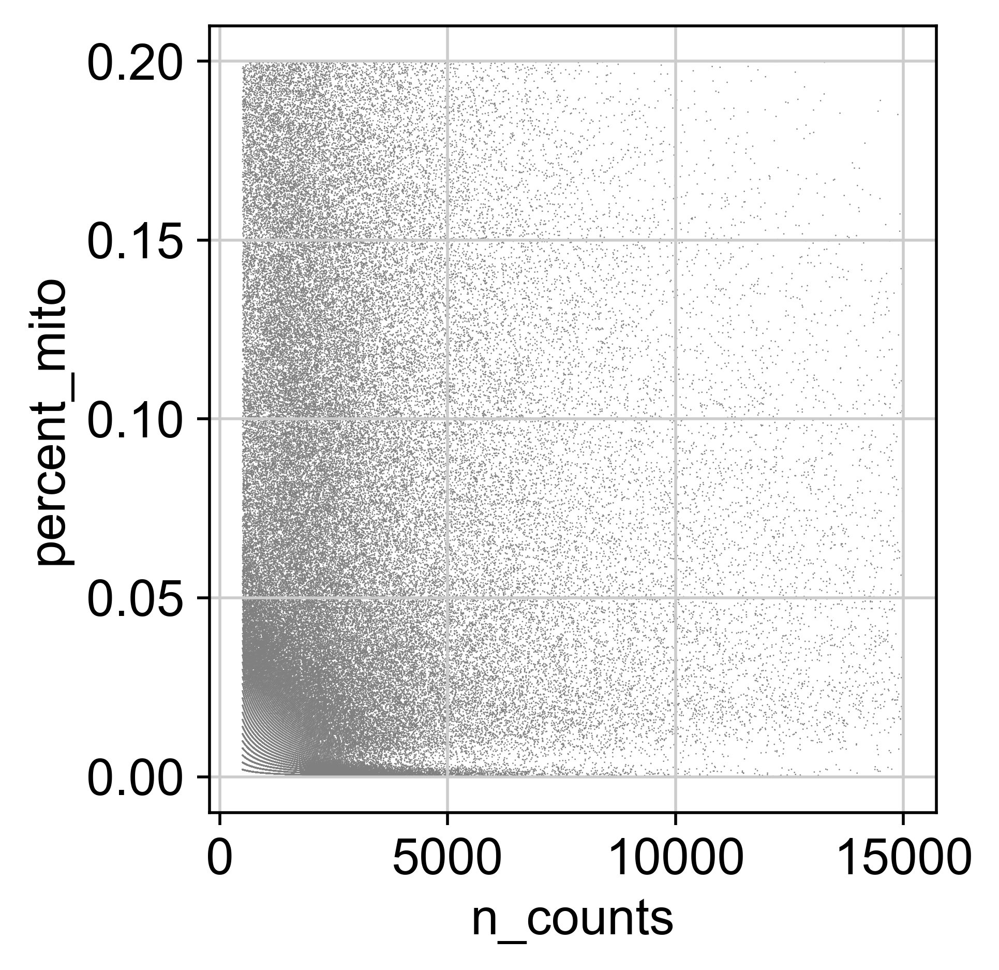

In [22]:
sc.pl.scatter(mod_vascular, x = 'n_counts', y = 'percent_mito')

## Adding Ensembl annotations to know the sex covariate of the sample

### Creating ensembl annotation

In [23]:
ensembl_annotations = sc.queries.biomart_annotations(
    "hsapiens",
    ["ensembl_gene_id", "external_gene_name", "start_position", "end_position", "chromosome_name"]
)

In [24]:
ensembl_annotations

,ensembl_gene_id,external_gene_name,start_position,end_position,chromosome_name
0,ENSG00000210049,MT-TF,577,647,MT
1,ENSG00000211459,MT-RNR1,648,1601,MT
2,ENSG00000210077,MT-TV,1602,1670,MT
3,ENSG00000210082,MT-RNR2,1671,3229,MT
4,ENSG00000209082,MT-TL1,3230,3304,MT
...,...,...,...,...,...
70706,ENSG00000288629,NaN,89579592,89579654,1
70707,ENSG00000288678,NaN,31919563,31938010,1
70708,ENSG00000290825,DDX11L2,11869,14409,1
70709,ENSG00000227232,WASH7P,14696,24886,1


In [25]:
mod_vascular.var.index

Index(['MIR1302-2HG', 'FAM138A', 'OR4F5', 'AL627309.1', 'AL627309.3',
       'AL627309.2', 'AL627309.4', 'AL732372.1', 'OR4F29', 'AC114498.1',
       ...
       'AC007325.2', 'BX072566.1', 'AL354822.1', 'AC023491.2', 'AC004556.1',
       'AC233755.2', 'AC233755.1', 'AC240274.1', 'AC213203.1', 'FAM231C'],
      dtype='object', length=33538)

### Adding ensembl annotation data into our data

In [26]:
# Preprocessing the index of var to have gene names without any suffix
mod_vascular_index_processed = [gene.split('.')[0] for gene in mod_vascular.var.index]

# Creating a column to store preprocessed gene names for mapping
mod_vascular.var['processed_gene_names'] = mod_vascular_index_processed
 
# Filtering ensembl_annotations for genes present in mod_vascular only
ensembl_annotations_filtered = ensembl_annotations.loc[ensembl_annotations['external_gene_name'].isin(mod_vascular_index_processed)]

# Removal of duplicates from ensembl annotation data
ensembl_annotations_filtered = ensembl_annotations_filtered.drop_duplicates(subset='external_gene_name')

# Indexing ensembl data with external_gene_name  and Mapping it with ensembl_gene_id
gene_mapping = ensembl_annotations_filtered.set_index('external_gene_name')['ensembl_gene_id']

# Map the processed gene names to the original gene names using gene_mapping
mod_vascular.var['ensembl_gene_id'] = mod_vascular.var['processed_gene_names'].map(gene_mapping)

# Now add other columns from ensembl_annotations_filtered to mod_vascular.var
additional_columns = ['start_position', 'end_position', 'chromosome_name']

for col in additional_columns:
    mod_vascular.var[col] = mod_vascular.var['processed_gene_names'].map(ensembl_annotations_filtered.set_index('external_gene_name')[col])

In [27]:
mod_vascular.var.to_csv("../Output/ensembl_anno.csv")

### Sex covariate analysis per sample

#### Chr Y genes calculation

In [28]:
chrY_genes = mod_vascular.var['chromosome_name'] == 'Y'
chrY_genes

MIR1302-2HG    False
FAM138A        False
OR4F5          False
AL627309.1     False
AL627309.3     False
               ...  
AC233755.2     False
AC233755.1     False
AC240274.1     False
AC213203.1     False
FAM231C        False
Name: chromosome_name, Length: 33538, dtype: bool

In [29]:
mod_vascular.obs['percent_chrY'] = np.sum(
    mod_vascular[:, chrY_genes].X, axis = 1) / np.sum(mod_vascular.X, axis = 1) * 100

mod_vascular.obs

,NRP,age_group,cell_source,cell_type,donor,gender,n_counts,n_genes,percent_mito,percent_ribo,...,predicted_doublets,n_genes_by_counts,total_counts,total_counts_MT,pct_counts_MT,total_counts_RIBO,pct_counts_RIBO,percent_mt2,n_counts2,percent_chrY
AAGACCTGTACTTGAC-1-HCAHeart7606896,No,50-55,Sanger-Cells,Smooth_muscle_cells,D1,Female,5236.0,1714,0.055959,0.050420,...,False,1714,5236.0,293.0,5.595875,654.0,12.490451,0.055959,5236.0,0.057296
ACAGCTACACAAGACG-1-HCAHeart7606896,No,50-55,Sanger-Cells,Pericytes,D1,Female,9139.0,3043,0.049568,0.065215,...,False,3043,9139.0,453.0,4.956779,1399.0,15.308021,0.049568,9139.0,0.120363
ACATCAGCATGACATC-1-HCAHeart7606896,No,50-55,Sanger-Cells,Pericytes,D1,Female,901.0,459,0.130966,0.048835,...,False,459,901.0,118.0,13.096560,116.0,12.874584,0.130966,901.0,0.221976
ACCCACTTCTGTCCGT-1-HCAHeart7606896,No,50-55,Sanger-Cells,Smooth_muscle_cells,D1,Female,3419.0,1220,0.090962,0.041533,...,False,1220,3419.0,311.0,9.096227,375.0,10.968120,0.090962,3419.0,0.029248
ACCTTTATCAATACCG-1-HCAHeart7606896,No,50-55,Sanger-Cells,Pericytes,D1,Female,5497.0,2177,0.075860,0.047480,...,False,2177,5497.0,417.0,7.585956,648.0,11.788248,0.075860,5497.0,0.127342
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGCGTCTCGAAGGAC-1-H0037_septum,No,55-60,Harvard-Nuclei,Endothelial,H4,Male,723.0,567,0.017981,0.000000,...,False,567,723.0,13.0,1.798064,1.0,0.138313,0.017981,723.0,0.138313
TTGCTGCTCTTTGCGC-1-H0037_septum,No,55-60,Harvard-Nuclei,Endothelial,H4,Male,515.0,389,0.015534,0.000000,...,False,389,515.0,8.0,1.553398,1.0,0.194175,0.015534,515.0,0.000000
TTGGTTTTCTTAGCAG-1-H0037_septum,No,55-60,Harvard-Nuclei,Endothelial,H4,Male,820.0,594,0.006098,0.000000,...,False,594,820.0,5.0,0.609756,3.0,0.365854,0.006098,820.0,0.121951
TTTGTTGAGGTAGATT-1-H0037_septum,No,55-60,Harvard-Nuclei,Endothelial,H4,Male,621.0,473,0.003221,0.000000,...,False,473,621.0,2.0,0.322061,1.0,0.161031,0.003221,621.0,0.000000


#### X-inactive specific transcript(XIST) genes calulation

In [30]:
if any(mod_vascular.var_names.str.match('Xist')):

    # Select variables having 'xist' in var_names
    xist_counts = mod_vascular.X[:, mod_vascular.var_names.str.match('Xist')].toarray()

    # Creating a series to store data
    xist_counts_series = pd.Series(xist_counts.squeeze(), index=mod_vascular.obs_names, name="XIST-counts")

    # Assigning the series back to our data into obs
    mod_vascular.obs["XIST-counts"] = xist_counts_series
else:
    print("No variable names matching the condition 'Xist' found.")

No variable names matching the condition 'Xist' found.


In [31]:
if any(mod_vascular.var_names.str.match('XIST')):

    # Select variables having 'xist' in var_names
    xist_counts = mod_vascular.X[:, mod_vascular.var_names.str.match('XIST')].toarray()

    # Creating a series to store data
    xist_counts_series = pd.Series(xist_counts.squeeze(), index=mod_vascular.obs_names, name="XIST-counts")

    # Assigning the series back to our data into obs
    mod_vascular.obs["XIST-counts"] = xist_counts_series

    print(mod_vascular.obs["XIST-counts"])
else:
    print("No variable names matching the condition 'Xist' found.")


AAGACCTGTACTTGAC-1-HCAHeart7606896    0.0
ACAGCTACACAAGACG-1-HCAHeart7606896    3.0
ACATCAGCATGACATC-1-HCAHeart7606896    0.0
ACCCACTTCTGTCCGT-1-HCAHeart7606896    1.0
ACCTTTATCAATACCG-1-HCAHeart7606896    2.0
                                     ... 
TTGCGTCTCGAAGGAC-1-H0037_septum       0.0
TTGCTGCTCTTTGCGC-1-H0037_septum       0.0
TTGGTTTTCTTAGCAG-1-H0037_septum       0.0
TTTGTTGAGGTAGATT-1-H0037_septum       0.0
TTTGTTGCAACTCATG-1-H0037_septum       0.0
Name: XIST-counts, Length: 195395, dtype: float32


In [32]:
mod_vascular

AnnData object with n_obs × n_vars = 195395 × 33538
    obs: 'NRP', 'age_group', 'cell_source', 'cell_type', 'donor', 'gender', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states', 'Used', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_MT', 'pct_counts_MT', 'total_counts_RIBO', 'pct_counts_RIBO', 'percent_mt2', 'n_counts2', 'percent_chrY', 'XIST-counts'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45', 'MT', 'RIBO', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'processed_gene_names', 'ensembl_gene_id', 'start_position', 'end_position', 'chromosome_name'
    uns: 'cell_type_colors', 'sample_colors'
    obsm: 'X_pca', 'X_umap'

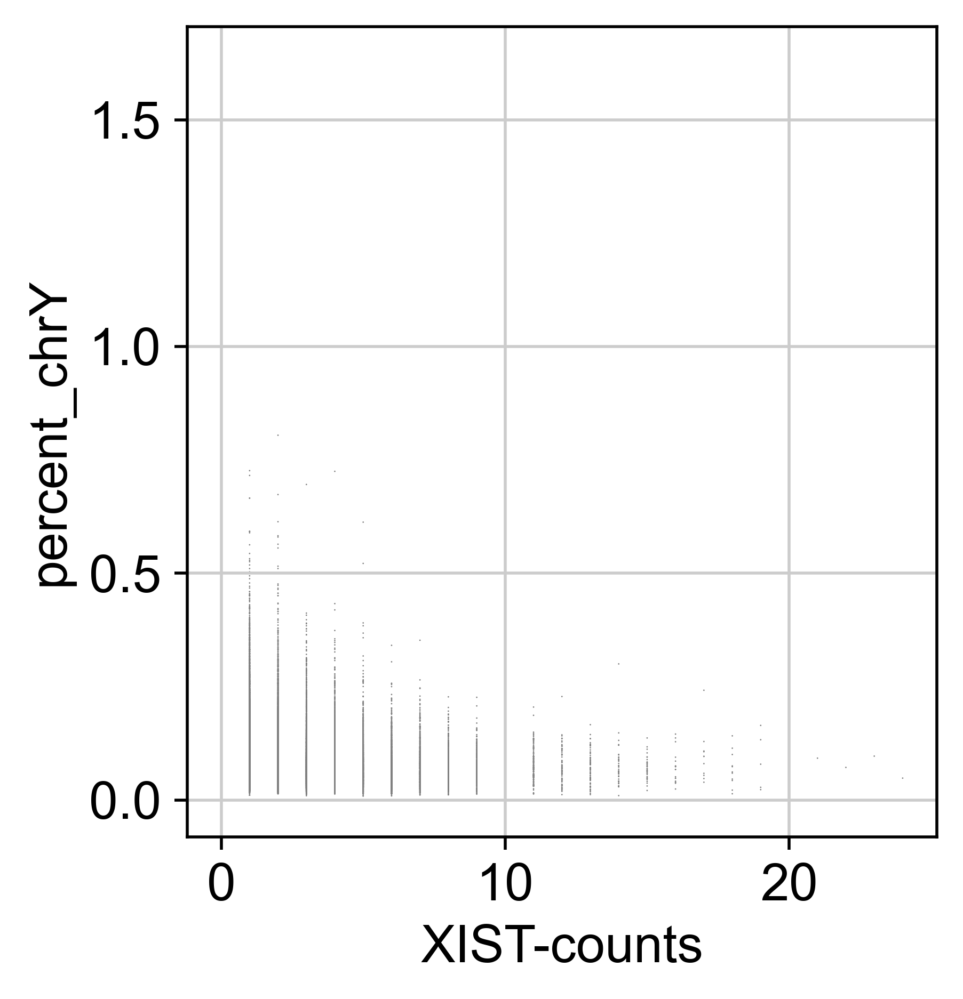

In [33]:
sc.pl.scatter(mod_vascular, x = 'XIST-counts', y = 'percent_chrY')

#### Data analysis
A higher XIST expression suggests characteristic of female cells. 

Higher percentage of Y chromosome transcripts suggests characteristic of male cells. 

When both XIST expression and percent_chrY are high in individual cells, it may indicate a discrepancy between male and female cell populations within the dataset, with cells exhibiting characteristics of both sexes.

/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has b

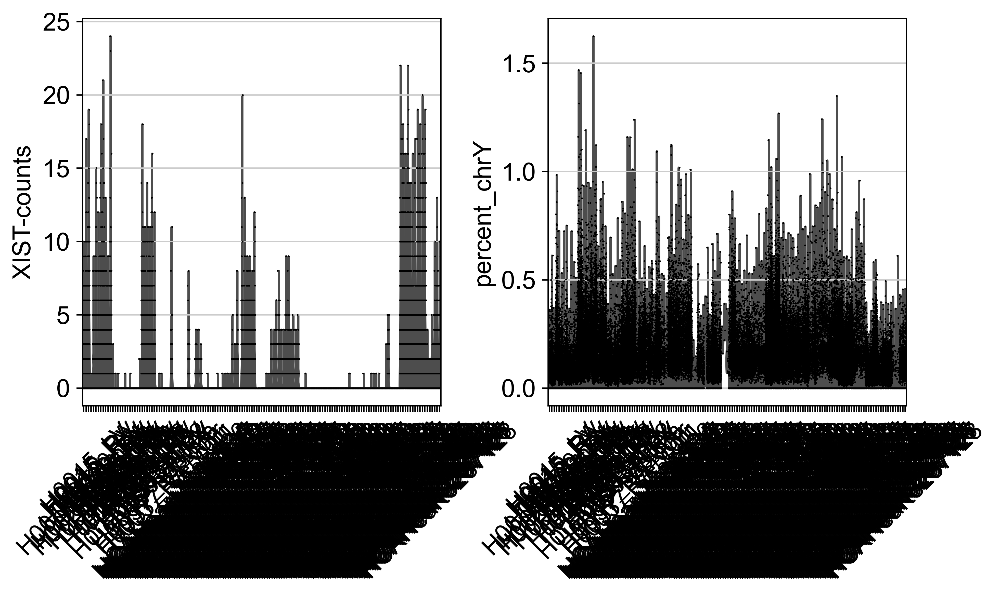

In [34]:
sc.pl.violin(mod_vascular, ["XIST-counts", "percent_chrY"], jitter = 0.4, groupby = 'sample', rotation = 45)

##### *Description of violin plots*

/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


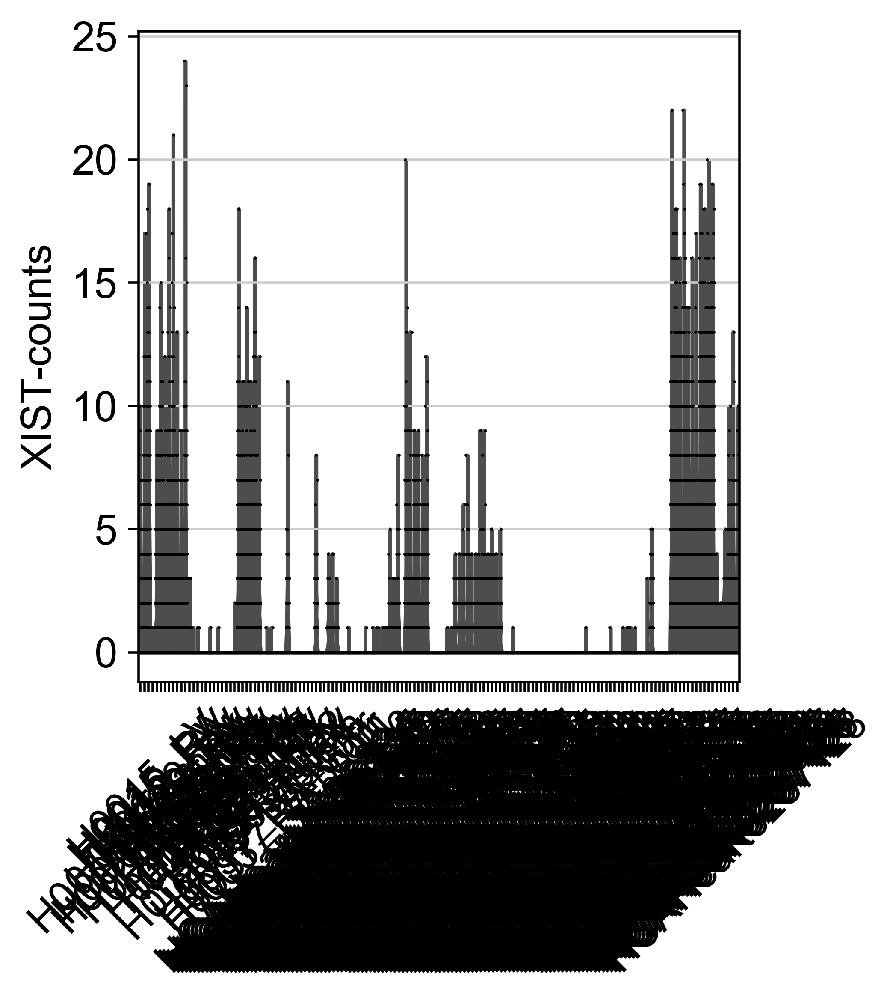

In [35]:
sc.pl.violin(mod_vascular, ["XIST-counts"], jitter = 0.4, groupby = 'sample', rotation = 45)

/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


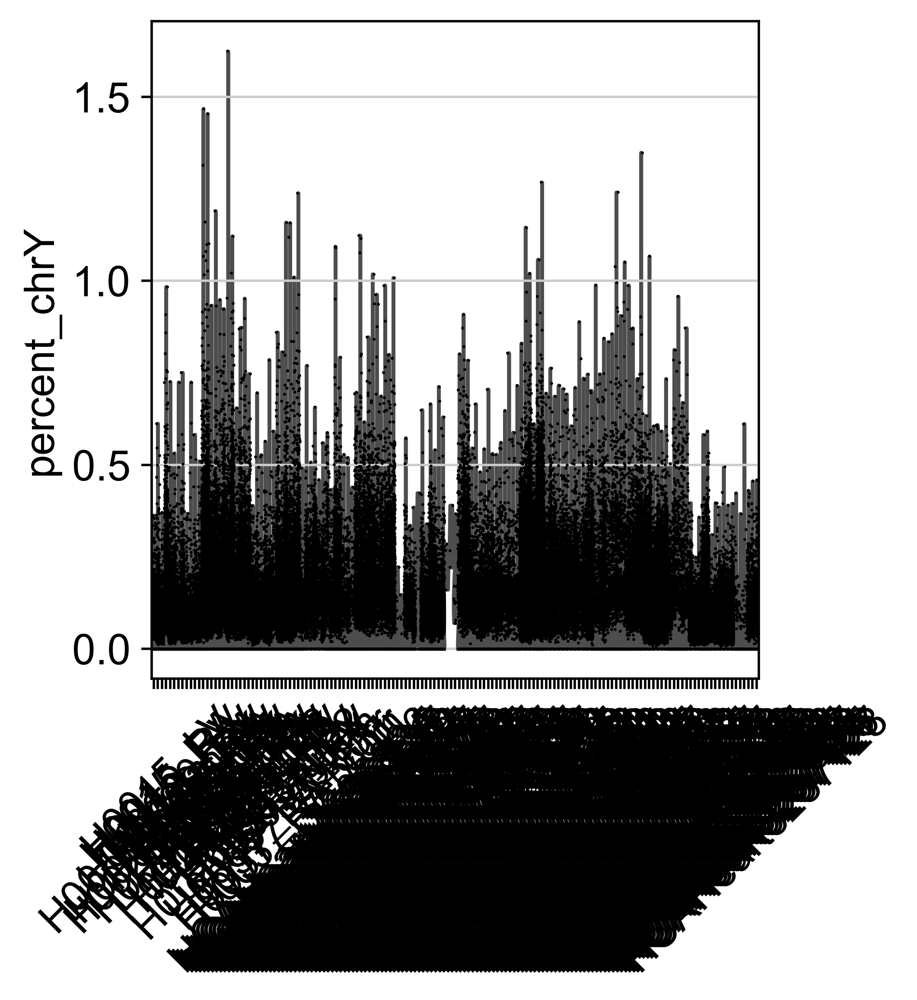

In [36]:
sc.pl.violin(mod_vascular, [ "percent_chrY"], jitter = 0.4, groupby = 'sample', rotation = 45)

## Calculation of cell cycle scores

##### Downloading the list of cell cycle genes

In [37]:
!if [ ! -f ../data/regev_lab_cell_cycle_genes.txt ]; then curl -o ../data/regev_lab_cell_cycle_genes.txt https://raw.githubusercontent.com/theislab/scanpy_usage/master/180209_cell_cycle/data/regev_lab_cell_cycle_genes.txt; fi

##### Marking of cell cycle genes

In [38]:
mod_vascular.var_names

Index(['MIR1302-2HG', 'FAM138A', 'OR4F5', 'AL627309.1', 'AL627309.3',
       'AL627309.2', 'AL627309.4', 'AL732372.1', 'OR4F29', 'AC114498.1',
       ...
       'AC007325.2', 'BX072566.1', 'AL354822.1', 'AC023491.2', 'AC004556.1',
       'AC233755.2', 'AC233755.1', 'AC240274.1', 'AC213203.1', 'FAM231C'],
      dtype='object', length=33538)

In [39]:
#Loading genes and captilizing 
cell_cycle_genes = [x.strip() for x in open('../Data/regev_lab_cell_cycle_genes.txt')]
cell_cycle_genes = [gene.capitalize() for gene in cell_cycle_genes]
print(len(cell_cycle_genes))

# Split into 2 lists
s_genes = cell_cycle_genes[:43] #First 43 genes
g2m_genes = cell_cycle_genes[43:] #Gene 43 to end

#Filtering cell cycle genes only if present in processed_gene_names
cell_cycle_genes_processed_gene_names = [x for x in cell_cycle_genes if x in mod_vascular.var['processed_gene_names']]
print(len(cell_cycle_genes_processed_gene_names))

#Filtering cell cycle genes only if present in processed_gene_names
cell_cycle_genes_var_names = [x for x in cell_cycle_genes if x in mod_vascular.var_names]
print(len(cell_cycle_genes_var_names))

#Filtering cell cycle genes only if present in processed_gene_names
cell_cycle_genes_var = [x for x in cell_cycle_genes if x in mod_vascular.var]
print(len(cell_cycle_genes_var))

97
0
0
0


/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has b

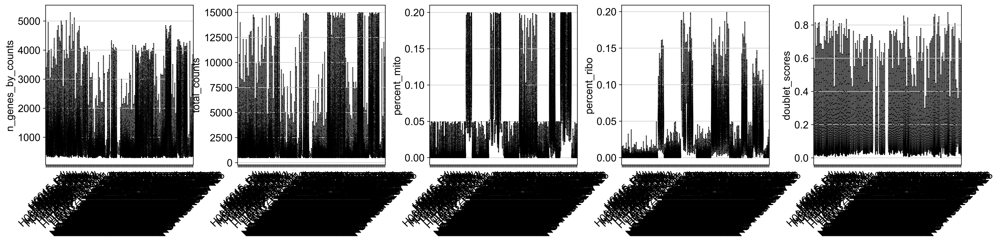

In [42]:
sc.pl.violin(mod_vascular, ['n_genes_by_counts', 'total_counts', 'percent_mito','percent_ribo', 'doublet_scores'],
             jitter = 0.2, groupby = 'sample', rotation = 45)

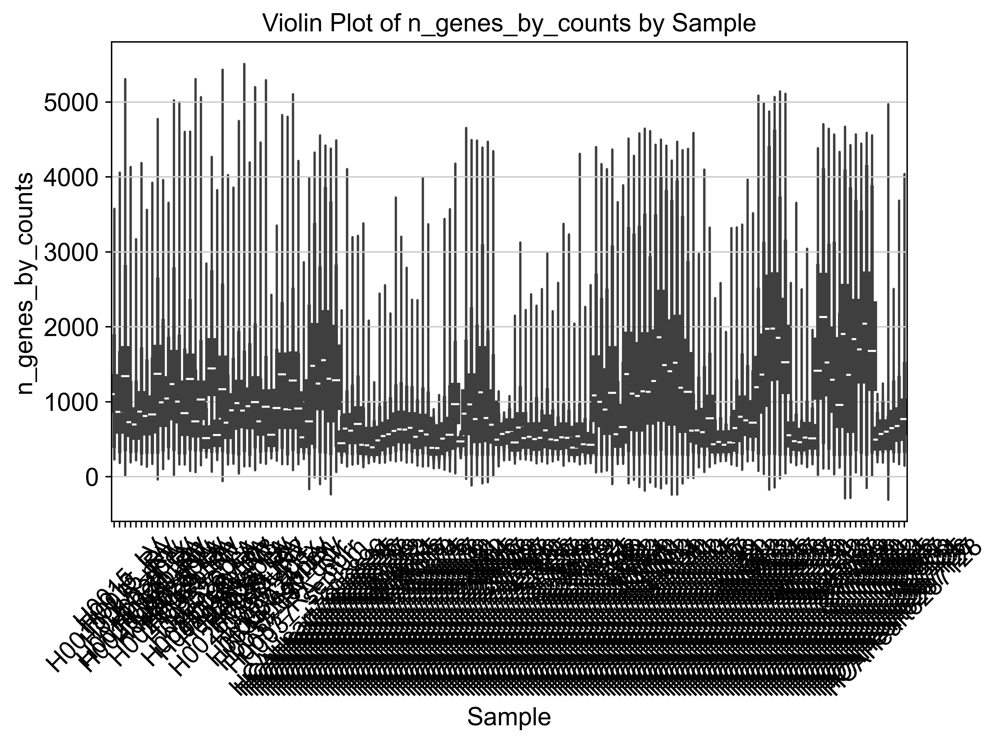

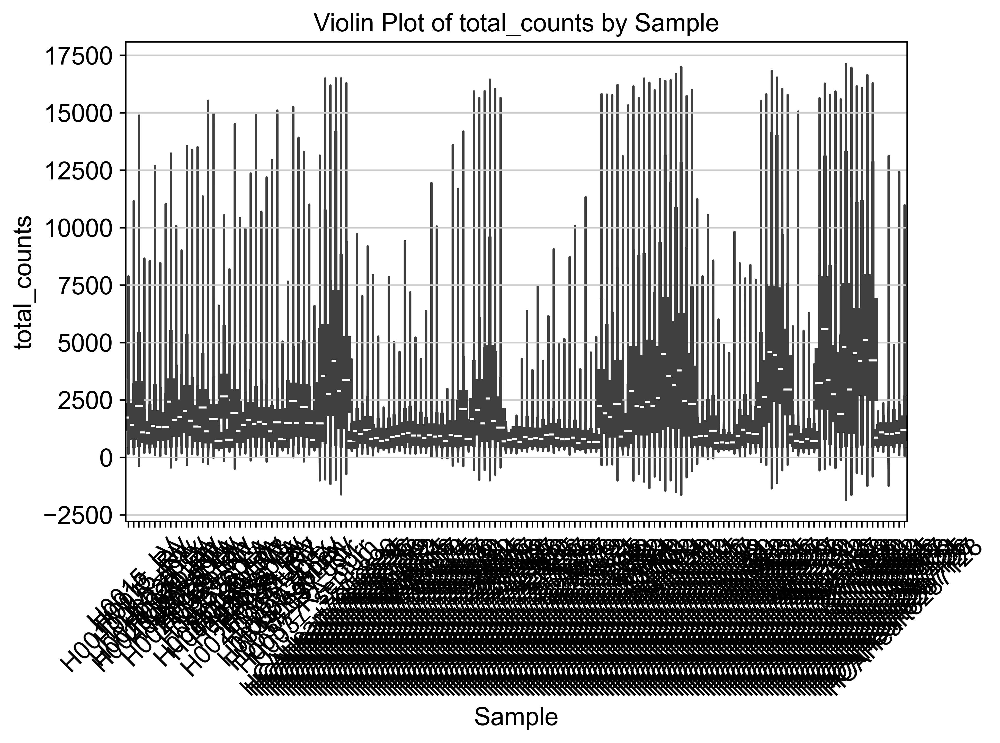

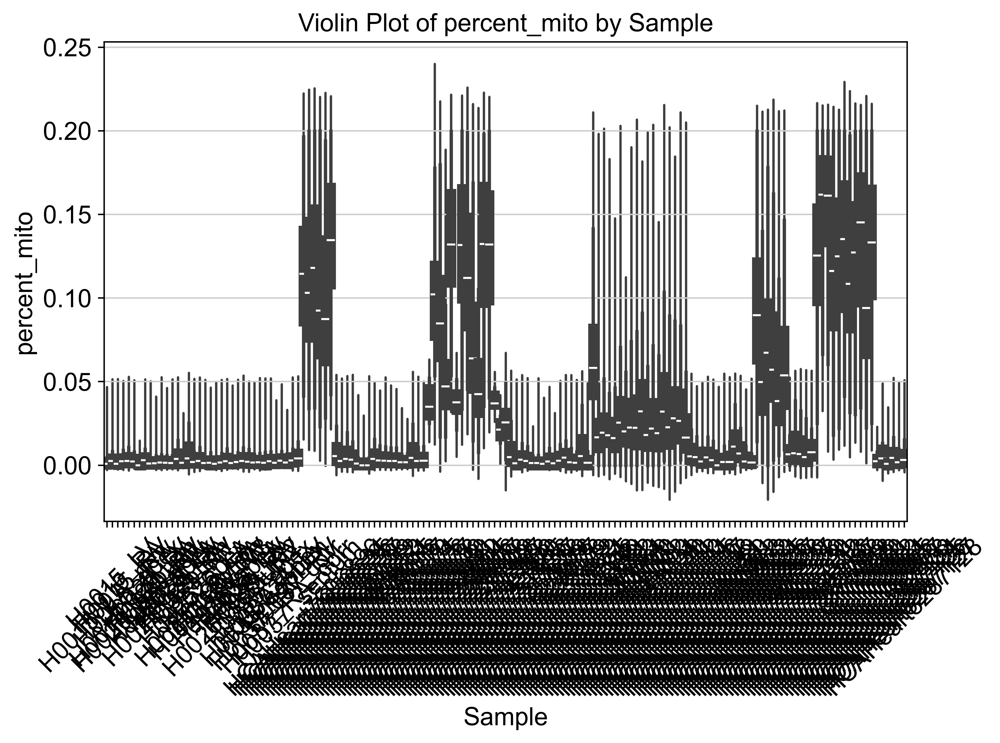

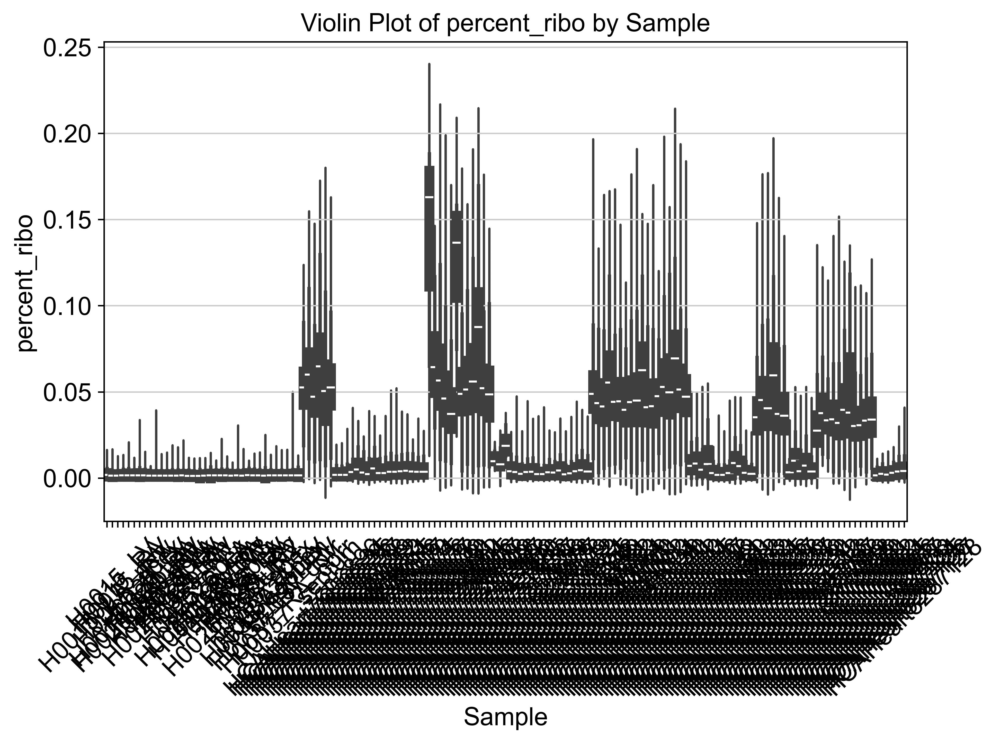

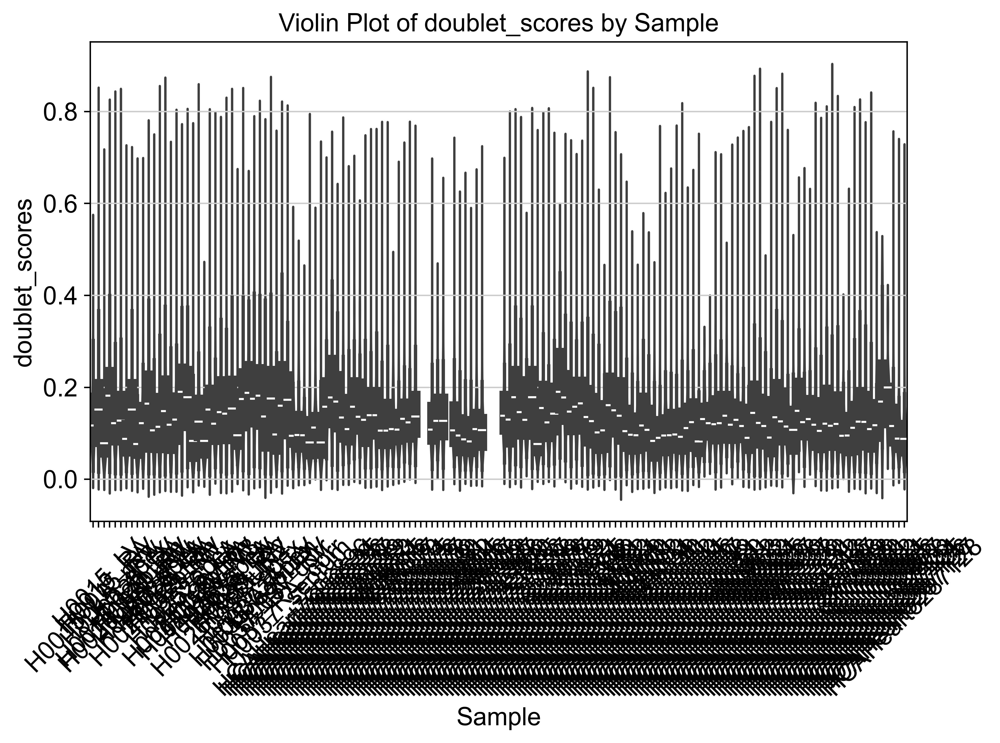

In [46]:
variables = ['n_genes_by_counts', 'total_counts', 'percent_mito', 'percent_ribo', 'doublet_scores']

for var in variables:
    plt.figure(figsize=(8, 6))
    sb.violinplot(data=mod_vascular.obs, x='sample', y=var)
    plt.title(f'Violin Plot of {var} by Sample')
    plt.xlabel('Sample')
    plt.ylabel(var)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.savefig(f'../output/{var}_violin_plot.png', dpi=300)
    plt.show()


##### Creating basic anndata and normalization for ceöll cycle score calculation

In [47]:
mod_vascular_log = anndata.AnnData(X = mod_vascular.X,  var = mod_vascular.var, obs = mod_vascular.obs)
sc.pp.normalize_total(mod_vascular_log , target_sum = 1e6, exclude_highly_expressed = True)
sc.pp.log1p(mod_vascular_log )

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['NPPA', 'PLA2G2A', 'JUN', 'S100A9', 'S100A8', 'ITLN1', 'RYR2', 'TMSB10', 'IGKC', 'TTN', 'DES', 'ADAMTS9', 'ATP1B3', 'LPP', 'APOD', 'LDB2', 'IGFBP7', 'JCHAIN', 'CXCL10', 'SPARCL1', 'ARL15', 'HSPA1A', 'ACTB', 'TMSB4X', 'TIMP1', 'DLC1', 'FABP5', 'FABP4', 'CCL21', 'TPM2', 'HBB', 'FTH1', 'NEAT1', 'MALAT1', 'TAGLN', 'ACTA2', 'MGP', 'LINC02388', 'IGHG4', 'IGHA1', 'IGHG1', 'IGHG3', 'IGHM', 'B2M', 'HBA2', 'HBA1', 'MT2A', 'HP', 'CCL2', 'TCAP', 'SLPI', 'JUNB', 'FTL', 'IGLC2', 'IGLC3', 'TIMP3', 'MT-CO1', 'MT-CO2', 'MT-ATP6', 'MT-CO3', 'MT-ND3']
    finished (0:00:00)


##### Calculating cell cycle scores

In [48]:
sc.tl.score_genes_cell_cycle(mod_vascular_log , s_genes = s_genes, g2m_genes = g2m_genes)
sc.pl.violin(mod_vascular_log , ['S_score', 'G2M_score'],
             jitter = 0.4, groupby = 'sample', rotation = 45)

calculating cell cycle phase
computing score 'S_score'


ValueError: No valid genes were passed for scoring.

## Data normalization

In [49]:
#Storing raw values
mod_vascular.raw = mod_vascular.copy()

#Storing counts before normalization as layer
mod_vascular.layers['counts'] = mod_vascular.X.copy()

#Normalization and storing the values in layers
mod_vascular.layers['sqrt_norm'] = np.sqrt(
    sc.pp.normalize_total(mod_vascular, inplace= False)["X"]
)

mod_vascular

normalizing counts per cell
    finished (0:00:00)


AnnData object with n_obs × n_vars = 195395 × 33538
    obs: 'NRP', 'age_group', 'cell_source', 'cell_type', 'donor', 'gender', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states', 'Used', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_MT', 'pct_counts_MT', 'total_counts_RIBO', 'pct_counts_RIBO', 'percent_mt2', 'n_counts2', 'percent_chrY', 'XIST-counts'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45', 'MT', 'RIBO', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'processed_gene_names', 'ensembl_gene_id', 'start_position', 'end_position', 'chromosome_name'
    uns: 'cell_type_colors', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts', 's

## Data Export

In [50]:
mod_vascular.write_h5ad("../Output/normalized_vascular.h5ad")

TypeError: Can't implicitly convert non-string objects to strings

In [51]:
mod_vascular.obs.dtypes

NRP                   category
age_group             category
cell_source           category
cell_type             category
donor                 category
gender                category
n_counts               float32
n_genes                  int64
percent_mito           float32
percent_ribo           float32
region                category
sample                category
scrublet_score         float64
source                category
type                  category
version               category
cell_states           category
Used                  category
doublet_scores         float64
predicted_doublets      object
n_genes_by_counts        int32
total_counts           float32
total_counts_MT        float32
pct_counts_MT          float32
total_counts_RIBO      float32
pct_counts_RIBO        float32
percent_mt2            float32
n_counts2              float32
percent_chrY           float64
XIST-counts            float32
dtype: object

In [52]:
mod_vascular.obs['predicted_doublets'] = mod_vascular.obs['predicted_doublets'].astype('category')

In [53]:
mod_vascular.write_h5ad("../Output/normalized_vascular.h5ad")